In [57]:
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
import matplotlib.pyplot as plt
from wordcloud import WordCloud
from math import log, sqrt
import pandas as pd
import numpy as np
import re
%matplotlib inline  
from sklearn.utils import shuffle
import re, string, unicodedata
import nltk
#import contractions
import inflect
from bs4 import BeautifulSoup
from nltk import word_tokenize, sent_tokenize
from nltk.corpus import stopwords
from nltk.stem import LancasterStemmer, WordNetLemmatizer

In [58]:
df_spam = pd.read_csv("spam.csv",encoding='latin-1')
df_ham = pd.read_csv("ham.csv",encoding='latin-1')

/anaconda3/lib/python3.6/site-packages/IPython/core/interactiveshell.py:2785: DtypeWarning: Columns (38,40,41,42,44,46,47,48,50,52,53,54,56,58,59,60,62,64,65,66,68,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,28

In [59]:
df_ham.head()

,SUBJECT,BODY,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,...,Unnamed: 88,Unnamed: 89,Unnamed: 90,Unnamed: 91,Unnamed: 92,Unnamed: 93,Unnamed: 94,Unnamed: 95,Unnamed: 96,Unnamed: 97
0,Screen on late 2010 iMac goes black.,<body><p>I have a 27â iMac and the screen ke...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Hey I wanted to get a refund on a subscription...,<body><span>UFC charged me 10.00 and I donât...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Apple TV iTunes movie and tv apps wonât load...,<body><span>About three days ago my Apple TV m...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Tracing down short pauses,<body><p>Every couple of days my computer lock...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Can i change my old Iphone to new one,<body><span>Is it possible to exchange my old ...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [60]:
df_ham.drop(list(df_ham.filter(regex='Unnamed')), axis=1, inplace=True)
df_spam.drop(list(df_spam.filter(regex='Unnamed')), axis=1, inplace=True)

In [61]:
df_ham.fillna(value='null', inplace=True)
df_spam.fillna(value='null', inplace=True)

In [62]:
def strip_html(text):
    soup = BeautifulSoup(text, "html.parser")
    return soup.get_text()

def remove_between_square_brackets(text):
    return re.sub('\[[^]]*\]', '', text)

def denoise_text(text):
    text = strip_html(text)
    text = remove_between_square_brackets(text)
    return text

df_ham['BODY']=df_ham['BODY'].apply((lambda x: denoise_text(x)))
df_spam['BODY']=df_spam['BODY'].apply((lambda x: denoise_text(x)))

In [7]:
# concatenate both SUBJECT and BODY
df_ham[1] = df_ham.SUBJECT.str.cat(df_ham.BODY)
df_spam[1] = df_spam.SUBJECT.str.cat(df_spam.BODY)

In [8]:
        # drop the columns SUBJECT from both ham and spam files
df_ham.drop(['SUBJECT', 'BODY'], axis=1, inplace=True)
df_spam.drop(['SUBJECT', 'BODY'], axis=1, inplace=True)

In [9]:
        # adding labels
df_ham[0] = 'ham'
df_spam[0] = 'spam'

In [10]:
# merge both data frames HAM and SPAM into One.
df = df_ham.append(df_spam, ignore_index=True)
df = shuffle(df)

In [11]:
df = df[pd.notnull(df[1])]
df.dropna()
# now process all the data
raw_text = df[1]

In [12]:
words=raw_text.apply(word_tokenize)

In [13]:
def remove_non_ascii(words):
    """Remove non-ASCII characters from list of tokenized words"""
    new_words = []
    for word in words:
        new_word = unicodedata.normalize('NFKD', word).encode('ascii', 'ignore').decode('utf-8', 'ignore')
        new_words.append(new_word)
    return new_words

def to_lowercase(words):
    """Convert all characters to lowercase from list of tokenized words"""
    new_words = []
    for word in words:
        new_word = word.lower()
        new_words.append(new_word)
    return new_words

def remove_punctuation(words):
    """Remove punctuation from list of tokenized words"""
    new_words = []
    for word in words:
        new_word = re.sub(r'[^\w\s]', '', word)
        if new_word != '':
            new_words.append(new_word)
    return new_words

def replace_numbers(words):
    """Replace all interger occurrences in list of tokenized words with textual representation"""
    p = inflect.engine()
    new_words = []
    for word in words:
        if word.isdigit():
            new_word = p.number_to_words(word)
            new_words.append(new_word)
        else:
            new_words.append(word)
    return new_words

def remove_stopwords(words):
    """Remove stop words from list of tokenized words"""
    new_words = []
    for word in words:
        if word not in stopwords.words('english'):
            new_words.append(word)
    return new_words

def stem_words(words):
    """Stem words in list of tokenized words"""
    stemmer = LancasterStemmer()
    stems = []
    for word in words:
        stem = stemmer.stem(word)
        stems.append(stem)
    return stems

def lemmatize_verbs(words):
    """Lemmatize verbs in list of tokenized words"""
    lemmatizer = WordNetLemmatizer()
    lemmas = []
    for word in words:
        lemma = lemmatizer.lemmatize(word, pos='v')
        lemmas.append(lemma)
    return lemmas

In [14]:
words=words.apply(remove_non_ascii)

In [15]:
words=words.apply(to_lowercase)

In [16]:
words=words.apply(remove_punctuation)

In [ ]:
#words=words.apply(replace_numbers)

In [ ]:
#words=words.apply(remove_stopwords)

In [17]:
words

25765    [re, not, getting, the, verification, email, o...
10966    [activation, lockmy, daughter, did, something,...
55942    [can, not, edit, in, pagesi, need, to, update,...
15513    [i, have, a, pending, apple, music, membership...
27094    [re, after, itunes, 127, how, can, i, add, cus...
51057    [re, iphone, update, causing, battery, to, die...
34683    [re, deleted, voice, memoshello, manuela, than...
53382    [pre, p, p, p, there, is, the, occasional, pos...
69412    [ausqaaa12aa, a, aausq , a e aqa34a744, 043, 1...
39159    [re, fcpx, has, no, audio, when, exportthat, w...
41827    [re, what, i, docould, you, ask, in, your, que...
61837                                         [p, p, null]
17191    [re, set, up, an, external, hdd, 2011, imac, 2...
60499       [re, fake, apple, support, keeps, popping, up]
20563    [new, contacts, are, entered, without, cardshe...
36313    [bootcampso, when, i, started, downloading, bo...
30570    [cant, uninstall, paragon, ntfsin, finder, i, .

In [ ]:
def remove_non_ascii(words):
    """Remove non-ASCII characters from list of tokenized words"""
    new_words = []
    for word in words:
        new_word = unicodedata.normalize('NFKD', word).encode('ascii', 'ignore').decode('utf-8', 'ignore')
        new_words.append(new_word)
    return new_words

def to_lowercase(words):
    """Convert all characters to lowercase from list of tokenized words"""
    new_words = []
    for word in words:
        new_word = word.lower()
        new_words.append(new_word)
    return new_words

def remove_punctuation(words):
    """Remove punctuation from list of tokenized words"""
    new_words = []
    for word in words:
        new_word = re.sub(r'[^\w\s]', '', word)
        if new_word != '':
            new_words.append(new_word)
    return new_words

def replace_numbers(words):
    """Replace all interger occurrences in list of tokenized words with textual representation"""
    p = inflect.engine()
    new_words = []
    for word in words:
        if word.isdigit():
            new_word = p.number_to_words(word)
            new_words.append(new_word)
        else:
            new_words.append(word)
    return new_words

def remove_stopwords(words):
    """Remove stop words from list of tokenized words"""
    new_words = []
    for word in words:
        if word not in stopwords.words('english'):
            new_words.append(word)
    return new_words

def stem_words(words):
    """Stem words in list of tokenized words"""
    stemmer = LancasterStemmer()
    stems = []
    for word in words:
        stem = stemmer.stem(word)
        stems.append(stem)
    return stems

def lemmatize_verbs(words):
    """Lemmatize verbs in list of tokenized words"""
    lemmatizer = WordNetLemmatizer()
    lemmas = []
    for word in words:
        lemma = lemmatizer.lemmatize(word, pos='v')
        lemmas.append(lemma)
    return lemmas

def normalize(words):
    words = remove_non_ascii(words)
    words = to_lowercase(words)
    words = remove_punctuation(words)
   #words = replace_numbers(words)
    words = remove_stopwords(words)
    return words

In [ ]:
words=words.apply(normalize)

In [18]:
df[1] = words[pd.notnull(words)]

In [19]:
all_data = list(df[[1, 0]].itertuples(index=False, name=None))

In [27]:
mails=df

In [28]:
mails.rename(columns = {0: 'labels', 1: 'message'}, inplace = True)
mails.head()

,message,labels
25765,"[re, not, getting, the, verification, email, o...",ham
10966,"[activation, lockmy, daughter, did, something,...",ham
55942,"[can, not, edit, in, pagesi, need, to, update,...",ham
15513,"[i, have, a, pending, apple, music, membership...",ham
27094,"[re, after, itunes, 127, how, can, i, add, cus...",ham


In [30]:
mails['labels'].value_counts()

ham     61429
spam    15550
Name: labels, dtype: int64

In [31]:
mails['label'] = mails['labels'].map({'ham': 0, 'spam': 1})
mails['message']= mails['message'].str.join(' ')
mails.head()

,message,labels,label
25765,"[re, not, getting, the, verification, email, o...",ham,0
10966,"[activation, lockmy, daughter, did, something,...",ham,0
55942,"[can, not, edit, in, pagesi, need, to, update,...",ham,0
15513,"[i, have, a, pending, apple, music, membership...",ham,0
27094,"[re, after, itunes, 127, how, can, i, add, cus...",ham,0


In [32]:
mails.drop(['labels'], axis = 1, inplace = True)
mails.head()

,message,label
25765,"[re, not, getting, the, verification, email, o...",0
10966,"[activation, lockmy, daughter, did, something,...",0
55942,"[can, not, edit, in, pagesi, need, to, update,...",0
15513,"[i, have, a, pending, apple, music, membership...",0
27094,"[re, after, itunes, 127, how, can, i, add, cus...",0


In [34]:
totalMails = 61429 + 15550
trainIndex, testIndex = list(), list()
for i in range(mails.shape[0]):
    if np.random.uniform(0, 1) < 0.75:
        trainIndex += [i]
    else:
        testIndex += [i]
trainData = mails.loc[trainIndex]
testData = mails.loc[testIndex]

In [35]:
trainData.reset_index(inplace = True)
trainData.drop(['index'], axis = 1, inplace = True)
trainData.head()

,message,label
0,"[screen, on, late, 2010, imac, goes, blacki, h...",0
1,"[apple, tv, itunes, movie, and, tv, apps, wona...",0
2,"[tracing, down, short, pausesevery, couple, of...",0
3,"[can, i, change, my, old, iphone, to, new, one...",0
4,"[for, ipad, mini, 4can, i, locker, app, on, th...",0


In [36]:
testData.reset_index(inplace = True)
testData.drop(['index'], axis = 1, inplace = True)
testData.head()

,message,label
0,"[hey, i, wanted, to, get, a, refund, on, a, su...",0
1,"[why, does, asystema, take, up, so, much, spac...",0
2,"[how, possible, is, it, to, use, a, lost, ipho...",0
3,"[will, the, current, sierra, version, of, ard,...",0
4,"[re, tracing, down, short, pausesyou, re, bett...",0


In [37]:
trainData['label'].value_counts()

0    46051
1    11610
Name: label, dtype: int64

In [38]:
testData['label'].value_counts()

0    15378
1     3940
Name: label, dtype: int64

In [40]:
mails['label']

25765    0
10966    0
55942    0
15513    0
27094    0
51057    0
34683    0
53382    0
69412    1
39159    0
41827    0
61837    1
17191    0
60499    0
20563    0
36313    0
30570    0
61928    1
43144    0
17267    0
28093    0
72570    1
15996    0
32460    0
36850    0
24701    0
47257    0
53301    0
12847    0
43764    0
        ..
74403    1
56282    0
25349    0
28938    0
68341    1
42936    0
38252    0
55066    0
45494    0
50889    0
2893     0
27117    0
50631    0
60336    0
33206    0
56015    0
8221     0
53854    0
38652    0
45552    0
46672    0
71773    1
66353    1
27012    0
58257    0
14236    0
57129    0
29889    0
48006    0
35530    0
Name: label, Length: 76979, dtype: int64

In [49]:
mails['message']= mails['message'].str.join(' ')

In [51]:
' '.join(list(mails[mails['label'] == 1]['message']))

'ausqaaa12aa a aausq  a e aqa34a744 043 126a343 2c a343 2a343 2aaee ausqaaaa a aausq a e aq a34a744 043 126a343 2c a343 2aa343 2aaee  p p null 09649422772 life love problem solution babaji delhi09649422772 life love problem solution babaji delhi 09649422772 life love problem solution babaji delhi 09649422772 life love problem solution babaji delhi 09649422772 life love problem solution babaji delhi 09649422772 life love problem solution babaji delhi 09649422772 life love problem solution babaji delhi 09649422772 life love problem solution babaji delhi 09649422772 life love problem solution babaji delhi 09649422772 life love problem solution babaji delhi 09649422772 life love problem solution babaji delhi v p it s hard to say but you have set a password try to remember it p null why not to change the mac hd to a shorter nameone of my friends buys a mac mini with os x 1058 and one of the very first things which i have noticed was the previous owner had changed the single drive name from 

In [52]:
spam_words = ' '.join(list(mails[mails['label'] == 1]['message']))

In [53]:
spam_words

'ausqaaa12aa a aausq  a e aqa34a744 043 126a343 2c a343 2a343 2aaee ausqaaaa a aausq a e aq a34a744 043 126a343 2c a343 2aa343 2aaee  p p null 09649422772 life love problem solution babaji delhi09649422772 life love problem solution babaji delhi 09649422772 life love problem solution babaji delhi 09649422772 life love problem solution babaji delhi 09649422772 life love problem solution babaji delhi 09649422772 life love problem solution babaji delhi 09649422772 life love problem solution babaji delhi 09649422772 life love problem solution babaji delhi 09649422772 life love problem solution babaji delhi 09649422772 life love problem solution babaji delhi 09649422772 life love problem solution babaji delhi v p it s hard to say but you have set a password try to remember it p null why not to change the mac hd to a shorter nameone of my friends buys a mac mini with os x 1058 and one of the very first things which i have noticed was the previous owner had changed the single drive name from 

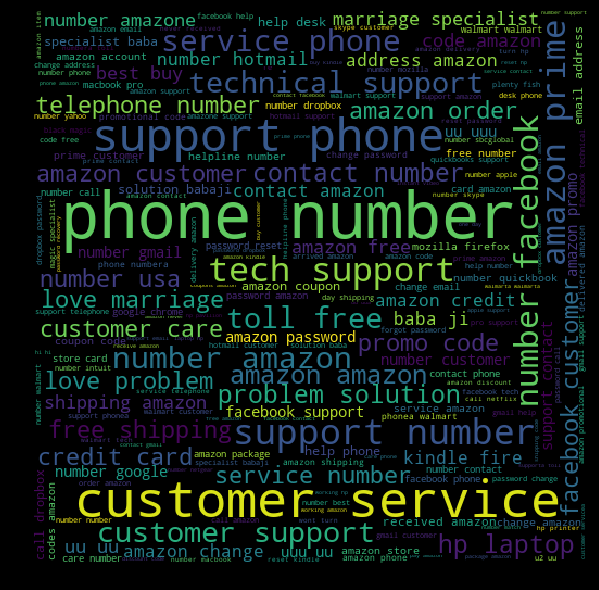

In [54]:
spam_wc = WordCloud(width = 512,height = 512).generate(spam_words)
plt.figure(figsize = (10, 8), facecolor = 'k')
plt.imshow(spam_wc)
plt.axis('off')
plt.tight_layout(pad = 0)
plt.show()

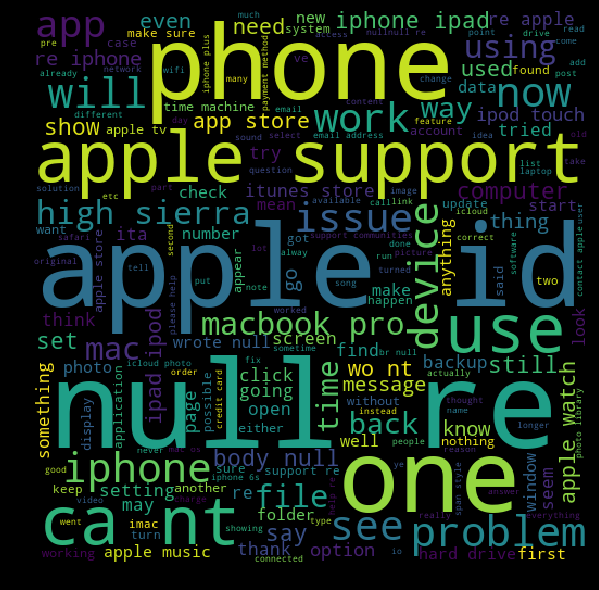

In [55]:
ham_words = ' '.join(list(mails[mails['label'] == 0]['message']))
ham_wc = WordCloud(width = 512,height = 512).generate(ham_words)
plt.figure(figsize = (10, 8), facecolor = 'k')
plt.imshow(ham_wc)
plt.axis('off')
plt.tight_layout(pad = 0)
plt.show()

In [56]:
trainData.head()

,message,label
0,"[screen, on, late, 2010, imac, goes, blacki, h...",0
1,"[apple, tv, itunes, movie, and, tv, apps, wona...",0
2,"[tracing, down, short, pausesevery, couple, of...",0
3,"[can, i, change, my, old, iphone, to, new, one...",0
4,"[for, ipad, mini, 4can, i, locker, app, on, th...",0


In [ ]:
trainData['label'].value_counts()

In [ ]:
testData.head()

In [ ]:
testData['label'].value_counts()

In [ ]:
def process_message(message, lower_case = True, stem = True, stop_words = True, gram = 2):
    if lower_case:
        message = message.lower()
    words = word_tokenize(message)
    words = [w for w in words if len(w) > 2]
    if gram > 1:
        w = []
        for i in range(len(words) - gram + 1):
            w += [' '.join(words[i:i + gram])]
        return w
    if stop_words:
        sw = stopwords.words('english')
        words = [word for word in words if word not in sw]
    if stem:
        stemmer = PorterStemmer()
        words = [stemmer.stem(word) for word in words]   
    return words

In [ ]:
trainData['message']

In [ ]:
process_message(' '.join(list(trainData['message'])), lower_case = True, stem = True, stop_words = True, gram = 2)

In [ ]:
process_message(' '.join( ['titl', 'goe', 'bold', 'text', 'it', 'text', 'stil', 'run', 'ran', 'run', 'stop', 'run', 'talk', 'talk', 'talk', 'run', 'ran', 'talk', 'run', 'sebast', 'nicola', 'alejandro', 'jeronimo', 'going', 'stor', 'tomorrow', 'morn', 'someth', 'wrong', 'sent', 'ca', 'nt', 'anym', 'nt', 'know', 'could', 'nt', 'din', 'resta', 'favorit', 'movy', 'franch', 'ord', 'indian', 'jon', 'marvel', 'cinem', 'univers', 'star', 'war', 'back', 'fut', 'harry', 'pot', 'nt', 'nt', 'bil', 'know', 'gre', 'littl', 'hous', 'got', 'john', 'wel', 'wel', 'wel', 'jam', 'lot', 'reason', 'one hundred and on', 'reason', 'one million', 'reason', 'act', 'go', 'get', 'two', 'tut', 'two', 'diff', 'stor', 'twenty-two', 'forty-five', 'one thousand and sixty-seven', 'four hundred and forty-five', 'stuff', 'insid', 'doubl', 'cur', 'brac', 'stuff', 'singl', 'cur', 'brac']))

In [ ]:
class SpamClassifier(object):
    def __init__(self, trainData, method = 'tf-idf'):
        self.mails, self.labels = trainData['message'], trainData['label']
        self.method = method

    def train(self):
        self.calc_TF_and_IDF()
        if self.method == 'tf-idf':
            self.calc_TF_IDF()
        else:
            self.calc_prob()

    def calc_prob(self):
        self.prob_spam = dict()
        self.prob_ham = dict()
        for word in self.tf_spam:
            self.prob_spam[word] = (self.tf_spam[word] + 1) / (self.spam_words + \
                                                                len(list(self.tf_spam.keys())))
        for word in self.tf_ham:
            self.prob_ham[word] = (self.tf_ham[word] + 1) / (self.ham_words + \
                                                                len(list(self.tf_ham.keys())))
        self.prob_spam_mail, self.prob_ham_mail = self.spam_mails / self.total_mails, self.ham_mails / self.total_mails 


    def calc_TF_and_IDF(self):
        noOfMessages = self.mails.shape[0]
        self.spam_mails, self.ham_mails = self.labels.value_counts()[1], self.labels.value_counts()[0]
        self.total_mails = self.spam_mails + self.ham_mails
        self.spam_words = 0
        self.ham_words = 0
        self.tf_spam = dict()
        self.tf_ham = dict()
        self.idf_spam = dict()
        self.idf_ham = dict()
        for i in range(noOfMessages):
            message_processed = process_message(self.mails[i])
            count = list() #To keep track of whether the word has ocured in the message or not.
                           #For IDF
            for word in message_processed:
                if self.labels[i]:
                    self.tf_spam[word] = self.tf_spam.get(word, 0) + 1
                    self.spam_words += 1
                else:
                    self.tf_ham[word] = self.tf_ham.get(word, 0) + 1
                    self.ham_words += 1
                if word not in count:
                    count += [word]
            for word in count:
                if self.labels[i]:
                    self.idf_spam[word] = self.idf_spam.get(word, 0) + 1
                else:
                    self.idf_ham[word] = self.idf_ham.get(word, 0) + 1

    def calc_TF_IDF(self):
        self.prob_spam = dict()
        self.prob_ham = dict()
        self.sum_tf_idf_spam = 0
        self.sum_tf_idf_ham = 0
        for word in self.tf_spam:
            self.prob_spam[word] = (self.tf_spam[word]) * log((self.spam_mails + self.ham_mails) \
                                                          / (self.idf_spam[word] + self.idf_ham.get(word, 0)))
            self.sum_tf_idf_spam += self.prob_spam[word]
        for word in self.tf_spam:
            self.prob_spam[word] = (self.prob_spam[word] + 1) / (self.sum_tf_idf_spam + len(list(self.prob_spam.keys())))
            
        for word in self.tf_ham:
            self.prob_ham[word] = (self.tf_ham[word]) * log((self.spam_mails + self.ham_mails) \
                                                          / (self.idf_spam.get(word, 0) + self.idf_ham[word]))
            self.sum_tf_idf_ham += self.prob_ham[word]
        for word in self.tf_ham:
            self.prob_ham[word] = (self.prob_ham[word] + 1) / (self.sum_tf_idf_ham + len(list(self.prob_ham.keys())))
            
    
        self.prob_spam_mail, self.prob_ham_mail = self.spam_mails / self.total_mails, self.ham_mails / self.total_mails 
                    
    def classify(self, processed_message):
        pSpam, pHam = 0, 0
        for word in processed_message:                
            if word in self.prob_spam:
                pSpam += log(self.prob_spam[word])
            else:
                if self.method == 'tf-idf':
                    pSpam -= log(self.sum_tf_idf_spam + len(list(self.prob_spam.keys())))
                else:
                    pSpam -= log(self.spam_words + len(list(self.prob_spam.keys())))
            if word in self.prob_ham:
                pHam += log(self.prob_ham[word])
            else:
                if self.method == 'tf-idf':
                    pHam -= log(self.sum_tf_idf_ham + len(list(self.prob_ham.keys()))) 
                else:
                    pHam -= log(self.ham_words + len(list(self.prob_ham.keys())))
            pSpam += log(self.prob_spam_mail)
            pHam += log(self.prob_ham_mail)
        return pSpam >= pHam
    
    def predict(self, testData):
        result = dict()
        for (i, message) in enumerate(testData):
            processed_message = process_message(message)
            result[i] = int(self.classify(processed_message))
        return result

In [ ]:
def metrics(labels, predictions):
    true_pos, true_neg, false_pos, false_neg = 0, 0, 0, 0
    for i in range(len(labels)):
        true_pos += int(labels[i] == 1 and predictions[i] == 1)
        true_neg += int(labels[i] == 0 and predictions[i] == 0)
        false_pos += int(labels[i] == 0 and predictions[i] == 1)
        false_neg += int(labels[i] == 1 and predictions[i] == 0)
    precision = true_pos / (true_pos + false_pos)
    recall = true_pos / (true_pos + false_neg)
    Fscore = 2 * precision * recall / (precision + recall)
    accuracy = (true_pos + true_neg) / (true_pos + true_neg + false_pos + false_neg)

    print("Precision: ", precision)
    print("Recall: ", recall)
    print("F-score: ", Fscore)
    print("Accuracy: ", accuracy)

In [ ]:
sc_tf_idf = SpamClassifier(trainData, 'tf-idf')
sc_tf_idf.train()
preds_tf_idf = sc_tf_idf.predict(testData['message'])
metrics(testData['label'], preds_tf_idf)

In [ ]:
sc_bow = SpamClassifier(trainData, 'bow')
sc_bow.train()
preds_bow = sc_bow.predict(testData['message'])
metrics(testData['label'], preds_bow)

In [ ]:
pm = process_message('I cant pick the phone right now. Pls send a message')
sc_tf_idf.classify(pm)

In [ ]:
pm = process_message('Congratulations ur awarded $500 ')
sc_tf_idf.classify(pm)